# Tutorial: Basic Usage and Application on Toggle-switch Simulation Dataset

In this tutorial, we introduce the basic usage of STT by walking through the analysis of simulation toggle-switch model of gene expression. This is a classical example of bi-stable states in systems biology.

In [1]:
import stt as st
import scanpy as sc
import matplotlib as mpl

In [2]:
adata = sc.read_h5ad('../data/toggle_switch/data_toggle_new.h5ad')

In [3]:
sc.pp.filter_genes(adata, min_cells=5)
sc.pp.normalize_total(adata, target_sum=1e4)

sc.pp.log1p(adata)
sc.pp.highly_variable_genes(adata, n_top_genes=3000)

In [4]:
import scvelo as scv
scv.pp.moments(adata)

computing moments based on connectivities
    finished (0:00:00) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)


## STT Analysis

To initilize STT, we need to provide the initial assignment of attractor (e.g. clusters or annotations). Typically, they are stored in the `obs` key of the `adata` object. In this example, we use the leiden clustering results.

Other key parameters include:

- `n_states`:	Number of attractors assigned in the STT analysis, which could be hinted by initial clustering or prior knowledge of annotations
- `n_neighbors`: Number of nearest neighbors used when constructing the tesnor-induced kernel, suggested value is 0.01* cell numbers
- `weight_connectivities`: Relative weight of cell gene-expression similarity-induced random walk kernel against tensor-induced kernel, suggested value is 0.5
- `n_components`:	Number of components used when estimating cell membership using GPCCA random walk transition probability matrix decomposition, default 21
- `thresh_entropy`:	Threshold of the 75% quantile of the cell membership relative entropy differences with last iteration to terminate iteration, default is 0.1
- `thresh_ms_gene`:	Threshold of minimum multi-stability score to select genes in the analysis in each iteration, suggested value is 0.2


Below is a example to run STT with customized settings:

In [5]:
adata.obs['attractor']=adata.obs['leiden']
adata_aggr = st.tl.dynamical_iteration(adata,n_states =2, n_iter = 20, n_neighbors = 100, n_components = 20, 
                                       weight_connectivities=0.2)

/home/bingsanyu/miniconda3/envs/stt/lib/python3.7/site-packages/pyemma/__init__.py:92: UserWarning: You are not using the latest release of PyEMMA. Latest is 2.5.7, you have 2.5.6.
  .format(latest=latest, current=current), category=UserWarning)


Mat Object: 1 MPI processes
  type: seqdense
9.9999999999999822e-01 3.5647812159468129e-06 2.1724665613776584e-03 -5.8349912606946372e-02 -3.5952794636719153e-02 3.0105797806057981e-02 -2.5925447129117336e-02 -5.6980624042034548e-03 4.5327235364193627e-03 2.6506974744730204e-02 -2.5916740532698029e-02 1.6903214222761882e-02 -3.5802246670646777e-02 1.1048111959652888e-02 -6.3285262662910726e-03 3.1307730653794601e-02 -8.8021825377338110e-03 2.6745039113102567e-02 2.2413392028075151e-02 3.3296318980941729e-02 
0.0000000000000000e+00 9.9999577459884625e-01 -1.4630208546219155e-03 -4.8287239419846896e-02 -2.9566933925509888e-02 -3.9116195871411762e-02 3.0672582429289798e-02 9.4211201383364359e-04 4.4496420352768701e-03 -3.1137699988170345e-02 2.7317702460779587e-02 -2.1059679662841804e-02 -3.4150653651231315e-02 4.9005049119645845e-03 7.9353690604838517e-03 -3.7228540927872984e-02 -6.1138201669413820e-04 -3.1877288679011934e-02 2.2433243677081098e-02 3.5327126875508034e-02 
0.0000000000000

/home/bingsanyu/1WORK/cwj/STT-release/example_notebooks/stt/tl/_dynamical_analysis.py:373: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  sc_object_aggr.obs['entropy'] = adata.obs['entropy'].values


We observe that the iteration halts when the 75% quantile of relative entropy difference is below 10%. 

To provide more flexibility, the function has one argument `monitor_mode`. When set to be `True`, the function will allow the user to inspect the output of each iteration, and choose to 1) continue the iteration or not, 2) change the hyper-parameter or not.

In [6]:
# adata_aggr = st.tl.dynamical_iteration(adata,n_states =2, n_iter = 20, n_neighbors = 100, n_components = 20, 
#                                        weight_connectivities=0.2, monitor_mode = True)
adata_aggr = st.tl.dynamical_iteration(adata,n_states =2, n_iter = 20, n_neighbors = 100, n_components = 20, 
                                       weight_connectivities=0.2, monitor_mode = False)

Mat Object: 1 MPI processes
  type: seqdense
9.9999999999999356e-01 3.9142635847605754e-06 4.3571289570307301e-04 -1.1778089661942572e-03 -6.9432982204030505e-02 -2.7912869108977674e-02 2.9209087239020388e-02 -1.2368757194307323e-02 1.7282184925366524e-03 -2.5854730954869658e-02 3.0187732509573902e-02 -1.5910348435188286e-02 4.3284525053746616e-02 -2.8514328688078554e-02 3.6517083579595030e-02 1.1800213912420724e-02 2.4150724364822431e-02 2.8454825097989872e-03 -4.8803351033788675e-02 1.2235707533903803e-02 
0.0000000000000000e+00 9.9999535855809429e-01 -2.0714910970558501e-04 -5.8183609048126275e-04 -5.7732943159861133e-02 3.3814801233644970e-02 -3.6283035675406451e-02 -9.8658377444702013e-03 1.5765905009191604e-03 3.0322016707633962e-02 -3.4571137715432923e-02 1.9629671633204730e-02 3.6138856170699014e-02 -2.2537007240319994e-02 -4.1425114799355442e-02 -1.4541021850528028e-02 -3.0249565319565543e-02 2.8905380624377778e-03 -3.9743540057643641e-02 1.4206658090295357e-02 
0.000000000000

/home/bingsanyu/1WORK/cwj/STT-release/example_notebooks/stt/tl/_dynamical_analysis.py:373: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  sc_object_aggr.obs['entropy'] = adata.obs['entropy'].values


Based on the output `adata_aggr`, which is the concatenation of unspliced and spliced counts of multi-stable genes, we next perform the PCA analysis to get the low dimensional embedding for visualization. In principle, any embedding can be used by setting the keys in `adata_aggr.obsm`. 

In [7]:
import scvelo as scv
sc.tl.pca(adata_aggr, svd_solver='arpack')

In [8]:
adata_aggr.obs['rho_1']= adata.uns['da_out']['membership'][:,1]
adata_aggr.obs['attractor'] = adata.obs['attractor']
adata_aggr.obs['leiden'] = adata.obs['leiden']

In [9]:
sc.set_figure_params(dpi=600,fontsize = 18)
sc.pl.embedding(adata_aggr,color = ['leiden','attractor','speed','entropy'],basis = 'pca')

The `st.pl.plot_tensor` provide functions to visualize the components of transition tensor.


In [10]:
import matplotlib.pyplot as plt
adata_aggr.obsm['X_pca']=adata.obsm['X_pca']
adata_aggr.obsm['X_pca_aggr']=adata.obsm['X_pca']
adata.obsm['X_pca_aggr']=adata.obsm['X_pca']
st.pl.plot_tensor(adata, adata_aggr,basis='pca',figsize = (10,10),wspace = 0.5)
plt.savefig('toggle_tensor.png')

check that the input includes aggregated object
computing velocity graph (using 16/16 cores)


  0%|          | 0/10010 [00:00<?, ?cells/s]

/home/bingsanyu/miniconda3/envs/stt/lib/python3.7/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  res = np.array(res) if as_array else res
/home/bingsanyu/miniconda3/envs/stt/lib/python3.7/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


    finished (0:00:28) --> added 
    'vj_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:02) --> added
    'vj_pca', embedded velocity vectors (adata.obsm)
check that the input includes aggregated object
computing velocity graph (using 16/16 cores)


  0%|          | 0/10010 [00:00<?, ?cells/s]

/home/bingsanyu/miniconda3/envs/stt/lib/python3.7/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  res = np.array(res) if as_array else res
[0]PETSC ERROR: ------------------------------------------------------------------------
[0]PETSC ERROR: Caught signal number 13 Broken Pipe: Likely while reading or writing to a socket
[0]PETSC ERROR: Try option -start_in_debugger or -on_error_attach_debugger
[0]PETSC ERROR: or see https://www.mcs.anl.gov/petsc/documentation/faq.html#valgrind
[0]PETSC ERROR: or try http://valgrind.org on GNU/linux and Apple Mac OS X to find memory corruption errors
[0]PETSC ERROR: configure using --with-debugging=yes, recompile, link, and run 
[0]PETSC ERROR: to get more information on the crash.
/home/

    finished (0:00:18) --> added 
    'vj_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:02) --> added
    'vj_pca', embedded velocity vectors (adata.obsm)
check that the input includes aggregated object
computing velocity graph (using 16/16 cores)


  0%|          | 0/10010 [00:00<?, ?cells/s]

/home/bingsanyu/miniconda3/envs/stt/lib/python3.7/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  res = np.array(res) if as_array else res
[0]PETSC ERROR: ------------------------------------------------------------------------
[0]PETSC ERROR: Caught signal number 13 Broken Pipe: Likely while reading or writing to a socket
[0]PETSC ERROR: Try option -start_in_debugger or -on_error_attach_debugger
[0]PETSC ERROR: or see https://www.mcs.anl.gov/petsc/documentation/faq.html#valgrind
[0]PETSC ERROR: or try http://valgrind.org on GNU/linux and Apple Mac OS X to find memory corruption errors
[0]PETSC ERROR: configure using --with-debugging=yes, recompile, link, and run 
[0]PETSC ERROR: to get more information on the crash.
/home/

    finished (0:00:17) --> added 
    'vj_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:02) --> added
    'vj_pca', embedded velocity vectors (adata.obsm)
computing velocity graph (using 16/16 cores)


  0%|          | 0/10010 [00:00<?, ?cells/s]

/home/bingsanyu/miniconda3/envs/stt/lib/python3.7/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  res = np.array(res) if as_array else res


    finished (0:00:06) --> added 
    'vs_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:01) --> added
    'vs_pca_aggr', embedded velocity vectors (adata.obsm)
computing velocity graph (using 16/16 cores)


  0%|          | 0/10010 [00:00<?, ?cells/s]

/home/bingsanyu/miniconda3/envs/stt/lib/python3.7/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  res = np.array(res) if as_array else res
[0]PETSC ERROR: ------------------------------------------------------------------------
[0]PETSC ERROR: Caught signal number 13 Broken Pipe: Likely while reading or writing to a socket
[0]PETSC ERROR: Try option -start_in_debugger or -on_error_attach_debugger
[0]PETSC ERROR: or see https://www.mcs.anl.gov/petsc/documentation/faq.html#valgrind
[0]PETSC ERROR: or try http://valgrind.org on GNU/linux and Apple Mac OS X to find memory corruption errors
[0]PETSC ERROR: configure using --with-debugging=yes, recompile, link, and run 
[0]PETSC ERROR: to get more information on the crash.


    finished (0:00:06) --> added 
    'vs_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:01) --> added
    'vs_pca_aggr', embedded velocity vectors (adata.obsm)
computing velocity graph (using 16/16 cores)


  0%|          | 0/10010 [00:00<?, ?cells/s]

/home/bingsanyu/miniconda3/envs/stt/lib/python3.7/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  res = np.array(res) if as_array else res
[0]PETSC ERROR: ------------------------------------------------------------------------
[0]PETSC ERROR: Caught signal number 13 Broken Pipe: Likely while reading or writing to a socket
[0]PETSC ERROR: Try option -start_in_debugger or -on_error_attach_debugger
[0]PETSC ERROR: or see https://www.mcs.anl.gov/petsc/documentation/faq.html#valgrind
[0]PETSC ERROR: or try http://valgrind.org on GNU/linux and Apple Mac OS X to find memory corruption errors
[0]PETSC ERROR: configure using --with-debugging=yes, recompile, link, and run 
[0]PETSC ERROR: to get more information on the crash.


    finished (0:00:06) --> added 
    'vs_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:01) --> added
    'vs_pca_aggr', embedded velocity vectors (adata.obsm)
computing velocity graph (using 16/16 cores)


  0%|          | 0/10010 [00:00<?, ?cells/s]

/home/bingsanyu/miniconda3/envs/stt/lib/python3.7/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  res = np.array(res) if as_array else res
[0]PETSC ERROR: ------------------------------------------------------------------------
[0]PETSC ERROR: Caught signal number 13 Broken Pipe: Likely while reading or writing to a socket
[0]PETSC ERROR: Try option -start_in_debugger or -on_error_attach_debugger
[0]PETSC ERROR: or see https://www.mcs.anl.gov/petsc/documentation/faq.html#valgrind
[0]PETSC ERROR: or try http://valgrind.org on GNU/linux and Apple Mac OS X to find memory corruption errors
[0]PETSC ERROR: configure using --with-debugging=yes, recompile, link, and run 
[0]PETSC ERROR: to get more information on the crash.


    finished (0:00:06) --> added 
    'vu_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:01) --> added
    'vu_pca_aggr', embedded velocity vectors (adata.obsm)
computing velocity graph (using 16/16 cores)


  0%|          | 0/10010 [00:00<?, ?cells/s]

/home/bingsanyu/miniconda3/envs/stt/lib/python3.7/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  res = np.array(res) if as_array else res
[0]PETSC ERROR: ------------------------------------------------------------------------
[0]PETSC ERROR: Caught signal number 13 Broken Pipe: Likely while reading or writing to a socket
[0]PETSC ERROR: Try option -start_in_debugger or -on_error_attach_debugger
[0]PETSC ERROR: or see https://www.mcs.anl.gov/petsc/documentation/faq.html#valgrind
[0]PETSC ERROR: or try http://valgrind.org on GNU/linux and Apple Mac OS X to find memory corruption errors
[0]PETSC ERROR: configure using --with-debugging=yes, recompile, link, and run 
[0]PETSC ERROR: to get more information on the crash.


    finished (0:00:07) --> added 
    'vu_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:02) --> added
    'vu_pca_aggr', embedded velocity vectors (adata.obsm)
computing velocity graph (using 16/16 cores)


  0%|          | 0/10010 [00:00<?, ?cells/s]

/home/bingsanyu/miniconda3/envs/stt/lib/python3.7/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  res = np.array(res) if as_array else res
[0]PETSC ERROR: ------------------------------------------------------------------------
[0]PETSC ERROR: Caught signal number 13 Broken Pipe: Likely while reading or writing to a socket
[0]PETSC ERROR: Try option -start_in_debugger or -on_error_attach_debugger
[0]PETSC ERROR: or see https://www.mcs.anl.gov/petsc/documentation/faq.html#valgrind
[0]PETSC ERROR: or try http://valgrind.org on GNU/linux and Apple Mac OS X to find memory corruption errors
[0]PETSC ERROR: configure using --with-debugging=yes, recompile, link, and run 
[0]PETSC ERROR: to get more information on the crash.


    finished (0:00:08) --> added 
    'vu_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:02) --> added
    'vu_pca_aggr', embedded velocity vectors (adata.obsm)


In [11]:
scv.tl.velocity_graph(adata_aggr,n_jobs=-1,vkey = 'vj')

computing velocity graph (using 16/16 cores)


  0%|          | 0/10010 [00:00<?, ?cells/s]

/home/bingsanyu/miniconda3/envs/stt/lib/python3.7/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  res = np.array(res) if as_array else res
[0]PETSC ERROR: ------------------------------------------------------------------------
[0]PETSC ERROR: Caught signal number 13 Broken Pipe: Likely while reading or writing to a socket
[0]PETSC ERROR: Try option -start_in_debugger or -on_error_attach_debugger
[0]PETSC ERROR: or see https://www.mcs.anl.gov/petsc/documentation/faq.html#valgrind
[0]PETSC ERROR: or try http://valgrind.org on GNU/linux and Apple Mac OS X to find memory corruption errors
[0]PETSC ERROR: configure using --with-debugging=yes, recompile, link, and run 
[0]PETSC ERROR: to get more information on the crash.


    finished (0:00:17) --> added 
    'vj_graph', sparse matrix with cosine correlations (adata.uns)


The user can also use the arguments in `st.pl.plot_tensor` to control the output, e.g. plot the tensor in only assigned attractor or splicing states. The "comprehensive" streamline considering both unspliced and spliced velocity is the "joint" attractor-averaged velocity of U and S multi-stability genes, which can be visualized using following command:

computing velocity embedding
    finished (0:00:02) --> added
    'vj_pca', embedded velocity vectors (adata.obsm)


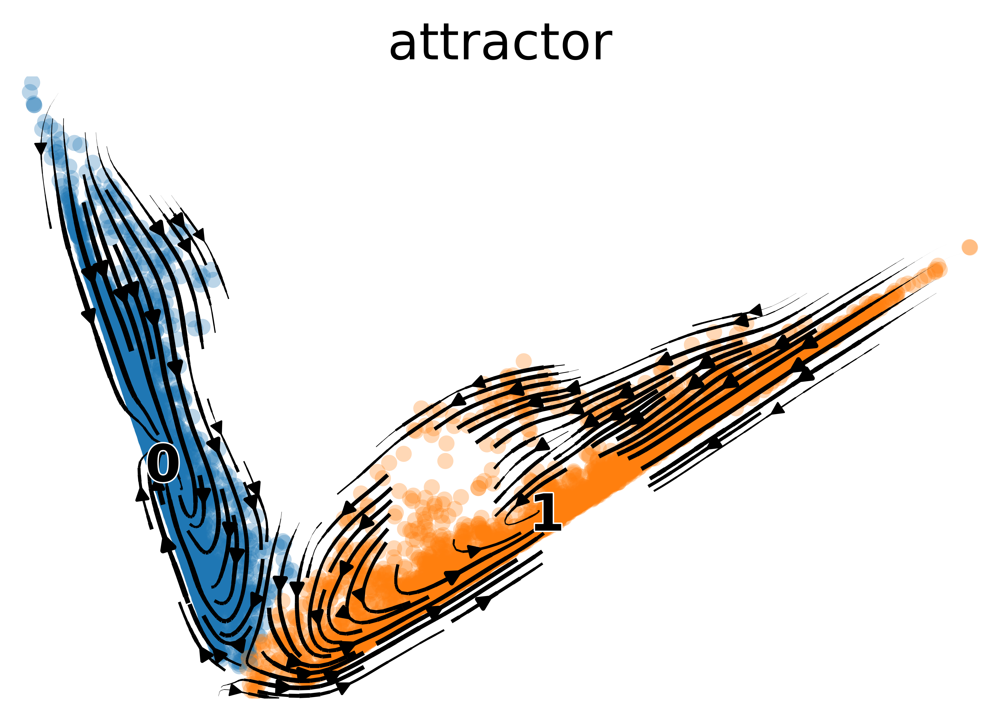

In [12]:
scv.set_figure_params(dpi =600,fontsize = 18)
scv.pl.velocity_embedding_stream(adata_aggr, basis='pca', color='attractor',vkey = 'vj',density = 3)

## Ground Truth and Benchmarking

In simulation data, we also record the ground truth velocity value that can be used for benchmarking and comparison.

In [13]:
import numpy as np
adata_aggr.layers['velo_true'] =np.concatenate((adata.layers['v_u'],adata.layers['v_s']),axis=1)

In [14]:
scv.tl.velocity_graph(adata_aggr,n_jobs=-1,vkey = 'velo_true')

computing velocity graph (using 16/16 cores)


  0%|          | 0/10010 [00:00<?, ?cells/s]

/home/bingsanyu/miniconda3/envs/stt/lib/python3.7/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  res = np.array(res) if as_array else res
[0]PETSC ERROR: ------------------------------------------------------------------------
[0]PETSC ERROR: Caught signal number 13 Broken Pipe: Likely while reading or writing to a socket
[0]PETSC ERROR: Try option -start_in_debugger or -on_error_attach_debugger
[0]PETSC ERROR: or see https://www.mcs.anl.gov/petsc/documentation/faq.html#valgrind
[0]PETSC ERROR: or try http://valgrind.org on GNU/linux and Apple Mac OS X to find memory corruption errors
[0]PETSC ERROR: configure using --with-debugging=yes, recompile, link, and run 
[0]PETSC ERROR: to get more information on the crash.


    finished (0:00:18) --> added 
    'velo_true_graph', sparse matrix with cosine correlations (adata.uns)


computing velocity embedding
    finished (0:00:02) --> added
    'velo_true_pca', embedded velocity vectors (adata.obsm)


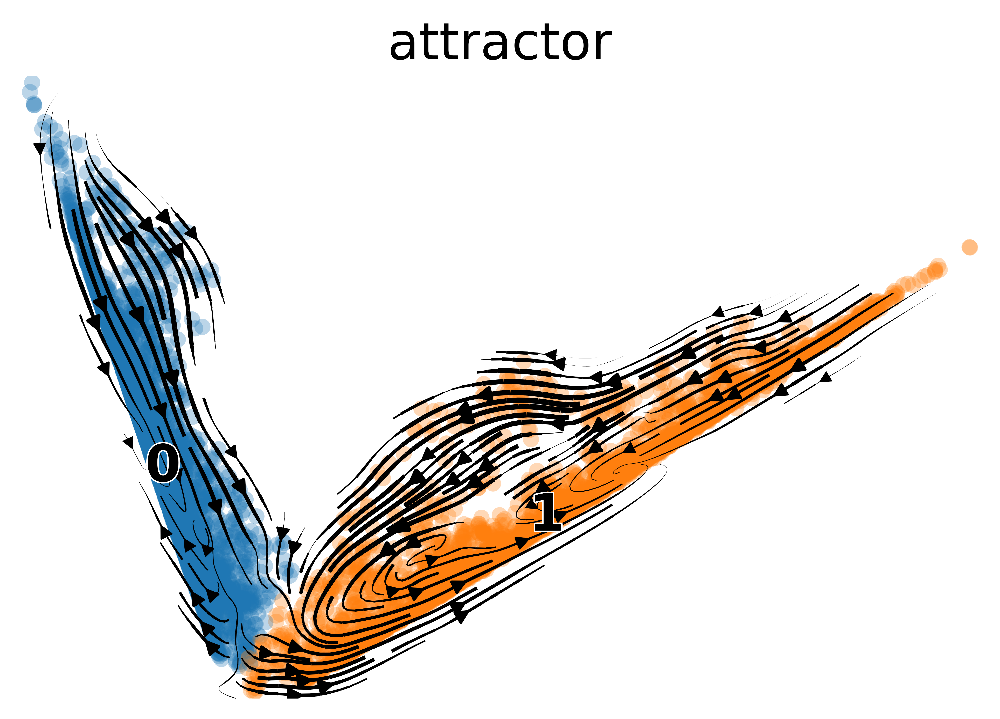

In [15]:
scv.pl.velocity_embedding_stream(adata_aggr, basis='pca', color='attractor',vkey = 'velo_true',density =3)

In [16]:
import numpy as np
def cosine_similarity(vec1, vec2):
    dot_product = np.dot(vec1, vec2)
    norm_vec1 = np.linalg.norm(vec1)
    norm_vec2 = np.linalg.norm(vec2)
    return dot_product / (norm_vec1 * norm_vec2)

arr1 = adata.layers['v_u']
arr2 = adata.obsm['tensor_v_aver'][:,:,0]
adata.obs['cos_u_st'] = np.array([cosine_similarity(arr1[i, :], arr2[i, :]) for i in range(arr1.shape[0])])

arr1 = adata.layers['v_u']
arr2 = adata.layers['velocity_u']
adata.obs['cos_u_scv'] = np.array([cosine_similarity(arr1[i, :], arr2[i, :]) for i in range(arr1.shape[0])])

arr1 = adata.layers['v_s']
arr2 = adata.obsm['tensor_v_aver'][:,:,1]
adata.obs['cos_s_st'] = np.array([cosine_similarity(arr1[i, :], arr2[i, :]) for i in range(arr1.shape[0])])

arr1 = adata.layers['v_s']
arr2 = adata.layers['velocity']
adata.obs['cos_s_scv'] = np.array([cosine_similarity(arr1[i, :], arr2[i, :]) for i in range(arr1.shape[0])])


In [17]:
sc.pl.embedding(adata,color = ['cos_u_st','cos_u_scv','cos_s_st','cos_s_scv'],basis = 'pca')

In [18]:
adata_cd = sc.read_h5ad('../data/results_celldancer.h5ad')
adata_ut = sc.read_h5ad('../data/results_unit.h5ad')

FileNotFoundError: [Errno 2] Unable to open file (unable to open file: name = '../data/results_celldancer.h5ad', errno = 2, error message = 'No such file or directory', flags = 0, o_flags = 0)

In [17]:
adata.obs['cos_s_unit'] = adata_ut.obs['cos_s_unit']
adata.obs['cos_s_cd'] = adata_cd.obs['cos_s_cd']
adata.obs['cos_u_cd'] = adata_cd.obs['cos_u_cd']


In [20]:
import matplotlib.pyplot as plt
import seaborn as sns
df_melted_u = adata.obs.melt(value_vars=['cos_u_st','cos_u_scv','cos_u_cd'])

In [36]:
# Plot
plt.figure(figsize=(10, 6))
sns.boxplot(x='variable', y='value', data=df_melted_u, palette = 'Set2')
plt.ylabel('Cosine Similarities')
new_labels = ['STT', 'ScVelo', 'CellDancer']  
plt.xticks(range(len(new_labels)), new_labels)
plt.xlabel('')
plt.show()

In [37]:
df_melted_s = adata.obs.melt(value_vars=['cos_s_st','cos_s_scv','cos_s_cd','cos_s_unit'])
plt.figure(figsize=(10, 6))
sns.boxplot(x='variable', y='value', data=df_melted_s, palette = 'Set2')
plt.ylabel('Cosine Similarities')
new_labels = ['STT', 'ScVelo', 'CellDancer','UniTVelo']  
plt.xticks(range(len(new_labels)), new_labels)
plt.xlabel('')
plt.show()

In [ ]:
adata.write('toggle_results.h5ad')

#import numpy as np
#np.save('../data/toggle_switch/toggle_pca.npy',adata_aggr.obsm['X_pca'])

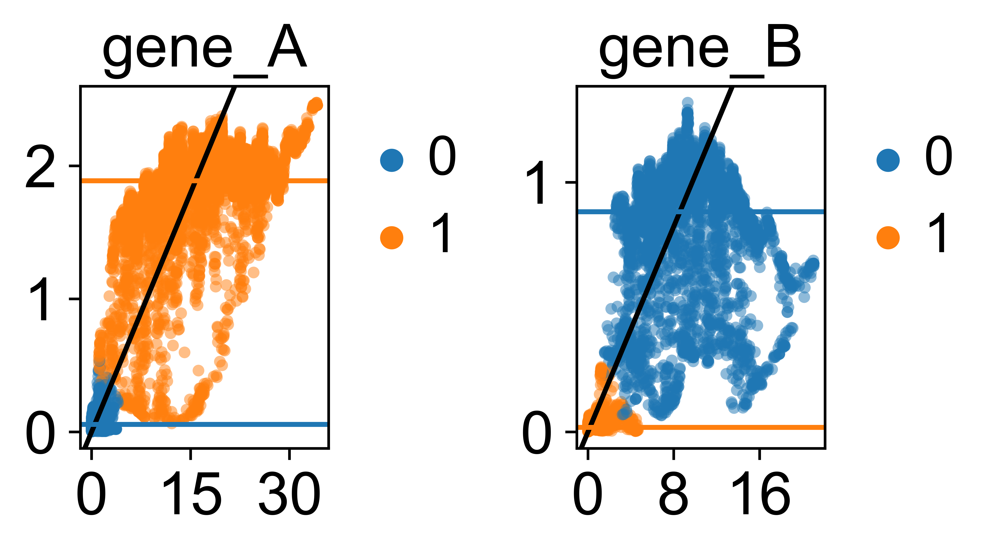

In [32]:
st.pl.plot_top_genes(adata, top_genes = 2, ncols =8, wspace = 1, hspace = 1,figsize=(20,2))

## Multi-stability kernel for CellRank Analysis

STT also outputs a multi-stability kernel based on transition tensor. This kernel can be directly used for downstream cellrank analysis, e.g. simulation of random walk.


In [32]:
kernel = adata.uns['kernel']

In [33]:
import cellrank as cr
g = cr.tl.estimators.GPCCA(kernel)

  0%|          | 0/10000 [00:00<?, ?sim/s]

[0]PETSC ERROR: 

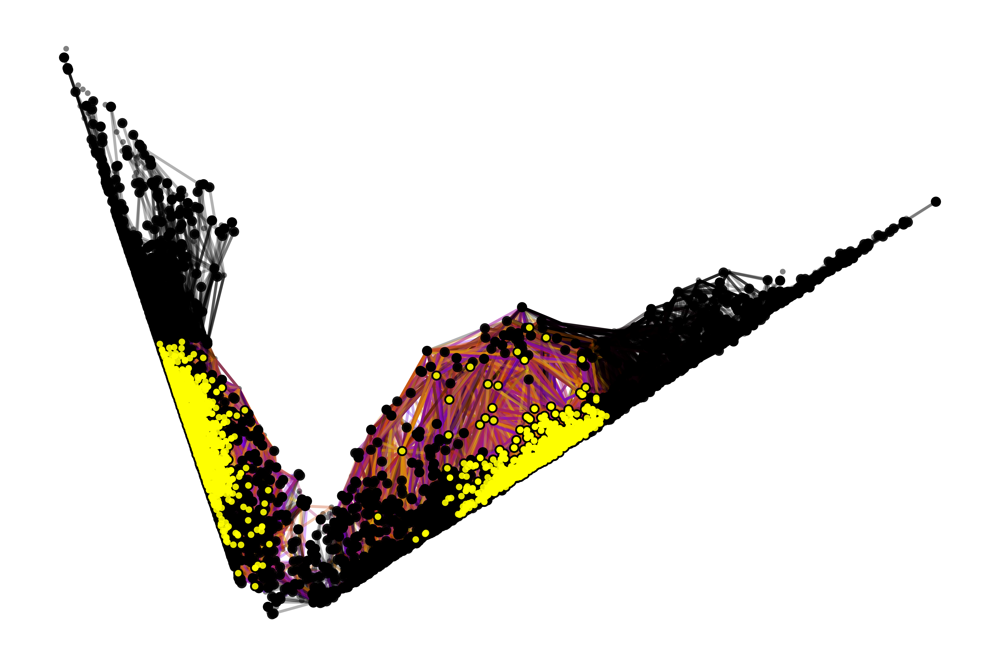

In [40]:
kernel.plot_random_walks(n_sims=10000,basis='pca',n_jobs=-1)

In [48]:
del adata.uns['kernel_connectivities']

In [50]:
del adata.uns['r2_keep_train']
del adata.uns['r2_keep_test']

In [51]:
adata.write('toggle_results.h5ad')